# Project from my personal Twitch Data

## 1 Import librairies

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import bar_chart_race as bcr
from functools import reduce
from cv2 import cv2
from wordcloud import WordCloud
from PIL import Image, ImageDraw, ImageFont
from sklearn import preprocessing

import time
import requests 
from bs4 import BeautifulSoup
import urllib.request
import csv
from fake_useragent import UserAgent

# Scraping 

In [16]:
follow2 = follow["channel"].drop_duplicates()
follow2

0               siraza
1              asusrog
2              skyyart
3                faker
4      quinnmastermind
            ...       
106              xurei
107               mizu
108     hittheroadlive
109              linca
110           gaspowrl
Name: channel, Length: 88, dtype: object

In [17]:
follow2 = pd.DataFrame(follow2)
follow2

,channel
0,siraza
1,asusrog
2,skyyart
3,faker
4,quinnmastermind
...,...
106,xurei
107,mizu
108,hittheroadlive
109,linca


In [56]:
for i in range (0,1):
    time.sleep(1)
    urlpage = 'https://twitchtracker.com/'+follow2.iloc[0]["channel"]+'/games'

    req = requests.get(urlpage, headers = {"User-Agent":"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_4) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/83.0.4103.97 Safari/537.36"})
    
    soup = BeautifulSoup(req.content, 'html.parser')
    
    table =  soup.find('div', attrs={'id': 'games-shares'})
    
    

    #follow2.at[follow2.index[i], "langue"] = text

In [45]:
soup

<!DOCTYPE html>

<html lang="en">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta content="width=device-width, initial-scale=1.0" name="viewport"/>
<title>SirAza - Played Games · TwitchTracker</title>
<meta content="Games played by SirAza on Twitch. Statistics and charts of all siraza streamed games." name="description"/>
<meta content="twitch, statistics, stream, channel, stats, games, subs, subscribers, clips, viewers, followers, views, shroud, ninja, drdisrespect, summit1g, lirik, dreadztv" name="keywords"/>
<script async="" src="https://pagead2.googlesyndication.com/pagead/js/adsbygoogle.js"></script>
<script>
        window.ga=window.ga||function(){(ga.q=ga.q||[]).push(arguments)};ga.l=+new Date;
        ga('create', 'UA-51794509-3', 'auto'); ga('send', 'pageview');
    </script>
<script async="" src="https://www.google-analytics.com/analytics.js"></script>
<link href="https://cdnjs.cloudflare.com/ajax/libs/bootswatch/3.3.7/flatly/bootst

In [57]:
table

<div class="clearfix" id="games-shares">
<div class="g-block" style="width: 10.6%;">
<div class="g-block-" data-toggle="tooltip" title="World of Warships">
<div class="volume">10.6%</div>
<div class="g-block--" style='background-image: url("https://static-cdn.jtvnw.net/ttv-boxart/World of Warships-108x144.jpg")'>
<div class="g-block---"></div>
</div>
</div>
</div>
<div class="g-block" style="width: 8.4%;">
<div class="g-block-" data-toggle="tooltip" title="Tom Clancy's Rainbow Six Siege">
<div class="volume">8.4%</div>
<div class="g-block--" style="background-image: url(&quot;https://static-cdn.jtvnw.net/ttv-boxart/Tom Clancy's Rainbow Six Siege-108x144.jpg&quot;)">
<div class="g-block---"></div>
</div>
</div>
</div>
<div class="g-block" style="width: 4.6%;">
<div class="g-block-" data-toggle="tooltip" title="PUBG: BATTLEGROUNDS">
<div class="volume">4.6%</div>
<div class="g-block--" style='background-image: url("https://static-cdn.jtvnw.net/ttv-boxart/PUBG: BATTLEGROUNDS-108x144.jpg")

[<a id="close-fixedban" onclick="document.getElementById('fixedban').style.display = 'none';" style="cursor:pointer;"><img alt="adplus-dvertising" src="https://ad.plus/adplus-advertising.svg" style="vertical-align:middle;" title="Ad.Plus Advertising"/></a>,
 <a class="navbar-brand" href="/">TwitchTracker</a>,
 <a class="navbar-static" href="/u/login" id="sign-in-button">
 <i class="fas fa-sign-in-alt fa-fw"></i>
 <span>SIGN IN</span>
 </a>,
 <a class="navbar-static" href="/u/dashboard" id="menu-user-icon">
 <img/>
 </a>,
 <a class="navbar-static" href="#" id="invoke-main-search-form">
 <i class="fas fa-search fa-fw"></i>
 <span>SEARCH</span>
 </a>,
 <a href="/channels/viewership">Channels</a>,
 <a href="/games">Games</a>,
 <a href="/clips">Clips</a>,
 <a class="dropdown-toggle" data-toggle="dropdown" href="#">Stats <span class="caret"></span></a>,
 <a href="/statistics">Overview</a>,
 <a href="/statistics/viewers">Viewers</a>,
 <a href="/statistics/channels">Channels</a>,
 <a href="/st

In [170]:
for i in len(table3):
    for j in len(table3[i]):
        liste.appned
print(type(table3[1]))

<class 'bs4.element.Tag'>


In [58]:
table2 = soup.findAll('div', attrs={'class': 'volume'})
for i in range(0,len(table2)):
    print(table2[i].getText())

10.6%
8.4%
4.6%
3.5%
72.9%


In [124]:
table3 = soup.findAll('div', attrs={'class': 'g-block-'})
for i in table:
    print(table[i])

KeyError: '\n'

In [127]:
print(table.get('class'))
for i in table:
   print(i.get('class'))

['clearfix']


AttributeError: 'NavigableString' object has no attribute 'get'

## 2 Import Datasets

In [15]:
ads = pd.read_csv("Furraly_ads.csv")
chats = pd.read_csv("Furraly_chats_cheers_sub_notifications.csv")
follow = pd.read_csv("Furraly_follow_unfollow.csv")
watched = pd.read_csv("Furraly_minutes_watched.csv")
pages = pd.read_csv("Furraly_pages_viewed.csv")
played = pd.read_csv("Furraly_video_s_played.csv")

## 3 Create KPI on my time spend on this platform

### 3.1 Create a heatmap 

In [232]:
def get_weekday(dt):
    return dt.weekday()

def get_month(dt):
    return dt.month

def get_month2(dt):
    x = dt.month
    if 1 <= x <= 4:
        x = "début (0,4)"
    elif 5 <= x <= 8:
        x = "milieu (5,8)"
    else:
        x = "fin (9,12)"
    return x

def get_dom(dt):
    return dt.day 

def get_year(dt):
    return dt.year

def get_hour(dt):
    return dt.hour

def count_rows(rows):
    return rows["context"].sum() / 60

def count_rows2(rows):
    return rows["event_type"].count()

def summ(total):
    return total["context"].sum()

In [42]:
watched["day"] = pd.to_datetime(watched["day"])
watched["year"] = watched["day"].map(get_year)

In [43]:
watched["day"] = pd.to_datetime(watched["day"])
watched["month"] = watched["day"].map(get_month) 

In [44]:
watched

,event_type,day,device_id,player,user_login,channel_name,context,year,month
0,minuteswatched,2015-03-30,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,coopgameplays,1.0,2015,3
1,minuteswatched,2015-03-30,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,mastersnakou,2.0,2015,3
2,minuteswatched,2015-03-30,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,tsukiyopower,8.0,2015,3
3,minuteswatched,2015-03-31,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,bowtieinmotion,3.0,2015,3
4,minuteswatched,2015-03-31,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,cyanide,3.0,2015,3
...,...,...,...,...,...,...,...,...,...
20758,minuteswatched,2021-09-08,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,21.0,2021,9
20759,minuteswatched,2021-09-08,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,5.0,2021,9
20760,minuteswatched,2021-09-08,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,36.0,2021,9
20761,minuteswatched,2021-09-08,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,1.0,2021,9


In [45]:
df = watched.groupby(['year', 'month']).apply(count_rows).unstack() #unstack command will change the Hours column to be above and horizontal
df.head(7)

month,1,2,3,4,5,6,7,8,9,10,11,12
year,,,,,,,,,,,,
2015,NaN,NaN,3.616667,6.850000,3.083333,6.333333,8.900000,2.750000,19.416667,31.133333,25.366667,16.883333
2016,26.616667,13.550000,36.366667,20.916667,16.950000,5.550000,3.666667,14.850000,27.100000,25.150000,8.400000,12.766667
2017,28.700480,14.404629,38.550910,16.069316,46.400000,34.383333,14.966667,4.416667,36.466667,13.200000,19.816667,3.550000
2018,6.633333,1.700000,6.000000,11.700000,10.750000,12.183333,1.316667,1.850000,41.900000,12.366667,25.300000,20.550000
2019,48.333333,23.566667,5.516667,8.650000,61.716667,0.683333,0.066667,6.000000,39.100000,31.600000,45.650000,62.233333
2020,1.716667,69.583333,78.450000,61.516667,53.000000,7.266667,9.266667,68.966667,145.550000,81.033333,126.350000,74.050000
2021,80.633333,144.316667,172.550000,215.200000,294.816667,261.916667,58.950000,140.300000,66.683333,NaN,NaN,NaN


In [40]:
watched.dtypes

event_type              object
day             datetime64[ns]
device_id               object
player                  object
user_login              object
channel_name            object
context                float64
year                     int64
month                    int64
dtype: object

In [39]:
fig3 = go.Figure(data=go.Heatmap(
                    z=df,
                    y=['2015'],
                   x=['1', '2','3','4','5','6','7','8','9','10','11','12'],
                   hoverongaps = False, 
                    xgap=1,
                    ygap=1,
                    ))
fig3.update_layout(title='Heatmap représentant le nombre d"heures passées sur Twitch par mois et par années')
fig3.show()

## Create a scatter plot 

In [92]:
watched["day"] = pd.to_datetime(watched["day"])
mask = ((watched["day"] < "2021-07-01") & (watched["day"] >= "2021-06-01" ))
watched = watched.loc[mask]
summ = watched.groupby("channel_name").sum()
summ = pd.DataFrame(summ)
summ = summ.reset_index()
summ["context"] = (summ["context"] / 60).round(0)
summ

,channel_name,context
0,aidraf,0.0
1,aiekillu,0.0
2,alexclick,5.0
3,amouranth,0.0
4,antoinedaniel,6.0
...,...,...
64,xari,0.0
65,xurei,0.0
66,yann,0.0
67,zacknani,0.0


In [93]:
summ['index'] = np.random.randint(0,len(summ), size=len(summ))

In [94]:
fig = px.scatter(summ, x="index", y="channel_name",size="context", size_max=45, log_x=True)
fig.show()

### Create an area plot

ISSUE with missing values

In [6]:
watched["day"] = pd.to_datetime(watched["day"])
watched = watched.set_index(watched["day"])
vision = watched[(watched["day"] > "2020-12-31")].groupby(["channel_name",pd.Grouper(freq='M')], as_index=True).apply(summ)

In [7]:
df = pd.DataFrame(vision)
df = df.reset_index()
df.columns = "channel","Mois de 2021","temps regardé en minutes"
df["Mois de 2021"] = df["Mois de 2021"].map(get_month) 

In [8]:
df = pd.merge(df,follow[['day', 'channel']],on='channel', how='outer')
df["day"] = pd.to_datetime(df["day"])
df["day"] = df["day"].map(get_year)
df.dropna(subset = ["day"], inplace=True)
df.dropna(subset = ["temps regardé en minutes"], inplace=True)

In [9]:
df["day"] = df["day"].astype(int).round(0)
df = df.sort_values(by=['day'])
df.columns = "channel","Mois de 2021","temps regardé en minutes","Année de soucscription à la chaîne"

In [10]:
fig = px.area(df, x="Mois de 2021", y="temps regardé en minutes", color="Année de soucscription à la chaîne",line_group="channel")
fig.show()

______

## Create some bar plots

In [200]:
watched["day"] = pd.to_datetime(watched["day"])
watched = watched.set_index(watched["day"])
vision = watched[(watched["day"] > "2020-12-31")].groupby(["channel_name",pd.Grouper(freq='M')], as_index=True).apply(summ)

In [201]:
df = pd.DataFrame(vision)
df = df.reset_index()
df.columns = "channel_name","Annee","context"
df["Annee"] = df["Annee"].map(get_month2) 
df["context"] = (df["context"] / 60).round(0)


In [202]:
df.columns = ("channel_name","Année 2021","Heures")

In [259]:
fig = px.histogram(df[:], x='channel_name', y='Heures',color='Année 2021',title="Graphique représentant le nombres d'heures passé sur les chaînes de stream en 2021")
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()

------------

In [17]:
watched["day"] = pd.to_datetime(watched["day"])
watched = watched.set_index(watched["day"])

In [18]:
df2 = pd.DataFrame(watched)
df2["day"] = df2["day"].map(get_year) 
df2["context"] = (df2["context"] / 60).round(0)

In [19]:
df2

,event_type,day,device_id,player,user_login,channel_name,context
day,,,,,,,
2015-03-30,minuteswatched,2015,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,coopgameplays,0.0
2015-03-30,minuteswatched,2015,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,mastersnakou,0.0
2015-03-30,minuteswatched,2015,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,tsukiyopower,0.0
2015-03-31,minuteswatched,2015,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,bowtieinmotion,0.0
2015-03-31,minuteswatched,2015,a59394f9abfb45c5a04f02153a0ff2bf,android,karrris,cyanide,0.0
...,...,...,...,...,...,...,...
2021-09-08,minuteswatched,2021,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,0.0
2021-09-08,minuteswatched,2021,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,0.0
2021-09-08,minuteswatched,2021,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,site,furraly,samueletienne,1.0


In [14]:
df2.columns = ("event","Annees","device","player","user","channel_name","heures")

In [15]:
fig2 = px.histogram(df2, x='channel_name', y='heures',color='Annees',title="Graphique représentant le nombres d'heures regardées par chaîne en fonction des années")
fig2.update_layout(xaxis={'categoryorder':'total descending'})
fig2.show()

### Create a bar chart race

Wich streamers to take for my bar chart race ? 
I will first plot an histogram which represent all the time spending on a channel. Then I can choose the first ones.

In [49]:
test = watched.groupby("channel_name").agg('sum')
test = test.reset_index()
fig = px.histogram(test, x='channel_name', y='context',)
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()

______

In [50]:
sammuel = pd.DataFrame()
shaunz = pd.DataFrame()
ponce = pd.DataFrame()

In [51]:
domingo = watched[(watched["channel_name"] == "domingo")]
skyyart = watched[(watched["channel_name"] == "skyyart")]
ponce = watched[(watched["channel_name"] == "ponce")]

In [52]:
domingo = domingo.drop(columns=['event_type','device_id','player','user_login','channel_name'])
skyyart = skyyart.drop(columns=['event_type','device_id','player','user_login','channel_name'])
ponce = ponce.drop(columns=['event_type','device_id','player','user_login','channel_name'])

In [53]:
domingo["day"] = pd.to_datetime(domingo["day"])
skyyart["day"] = pd.to_datetime(skyyart["day"])
ponce["day"] = pd.to_datetime(ponce["day"])

In [54]:
domingo = domingo.set_index(["day"])
skyyart = skyyart.set_index(["day"])
ponce = ponce.set_index(["day"])

In [55]:
domingo.nunique

<bound method DataFrame.nunique of             context
day                
2015-04-20      2.0
2015-04-23      6.0
2015-04-25     21.0
2015-04-25      2.0
2015-04-25      8.0
...             ...
2021-09-04      1.0
2021-09-04      8.0
2021-09-04      2.0
2021-09-04      3.0
2021-09-04     44.0

[1960 rows x 1 columns]>

In [56]:
group = domingo.groupby("day").sum()
domingo = pd.DataFrame(group)
domingo.reset_index()

,day,context
0,2015-04-20,2.0
1,2015-04-23,6.0
2,2015-04-25,31.0
3,2015-04-26,4.0
4,2015-05-24,9.0
...,...,...
577,2021-08-27,9.0
578,2021-08-28,1.0
579,2021-08-30,210.0
580,2021-08-31,29.0


In [57]:
group2 = skyyart.groupby("day").sum()
skyyart = pd.DataFrame(group2)
skyyart.reset_index()

,day,context
0,2017-02-01,2.305861
1,2017-02-04,40.361675
2,2017-02-11,1.154043
3,2017-02-12,24.228572
4,2017-02-18,26.408272
...,...,...
324,2021-08-23,3.000000
325,2021-08-25,1.000000
326,2021-08-26,1.000000
327,2021-09-05,1.000000


In [58]:
group3 = ponce.groupby("day").sum()
ponce = pd.DataFrame(group3)
ponce.reset_index()

,day,context
0,2019-09-02,5.0
1,2019-12-02,4.0
2,2019-12-09,9.0
3,2020-02-04,1.0
4,2020-02-05,17.0
...,...,...
297,2021-09-03,68.0
298,2021-09-05,211.0
299,2021-09-06,91.0
300,2021-09-07,148.0


In [59]:
domingo.columns = "domingo",
skyyart.columns = "skyyart",
ponce.columns = "ponce",

In [60]:
dfs = [skyyart,domingo,ponce]
fin = reduce(lambda df_left,df_right: pd.merge(df_left, df_right,left_index=True, right_index=True,how='outer'),dfs)

In [63]:
fin

,skyyart,domingo,ponce
day,,,
2015-04-20,0.000000,2.00000,0.0
2015-04-23,0.000000,8.00000,0.0
2015-04-25,0.000000,39.00000,0.0
2015-04-26,0.000000,43.00000,0.0
2015-05-24,0.000000,52.00000,0.0
...,...,...,...
2021-09-04,12522.101915,22618.16943,25699.0
2021-09-05,12523.101915,22618.16943,25910.0
2021-09-06,12523.101915,22618.16943,26001.0


In [61]:
fin["domingo"] = fin["domingo"].fillna(0)
fin["skyyart"] = fin["skyyart"].fillna(0)
fin["ponce"] = fin["ponce"].fillna(0)

In [62]:
fin["domingo"] = fin["domingo"].cumsum()
fin["skyyart"] = fin["skyyart"].cumsum()
fin["ponce"] = fin["ponce"].cumsum()

In [100]:
def summary(values, ranks):
    total_minutes = int(round(values.sum(), -2))
    s = f'Total minutes  : {total_minutes:,.0f}'
    return {'x': .99, 'y': .05, 's': s, 'ha': 'right', 'size': 8}

In [99]:
bcr.bar_chart_race(df=fin, sort='asc',steps_per_period=20,period_length=200,period_summary_func=summary)

/Users/benoit/opt/anaconda3/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:286: UserWarning:

FixedFormatter should only be used together with FixedLocator

/Users/benoit/opt/anaconda3/lib/python3.8/site-packages/bar_chart_race/_make_chart.py:287: UserWarning:

FixedFormatter should only be used together with FixedLocator



## Create a word cloud  

faire une barre de recherche

In [8]:
chats = chats[chats["event_type"] == "chat"]

In [9]:
chats["context"] = chats["context"].astype('string')
chats["context"].dtypes
text = chats["context"].tolist()
text = ' '.join([str(item) for item in text])

In [10]:
mask = np.array(Image.open("logo2.png"))
mask = cv2.bitwise_not(mask)

In [10]:
def random_color_func(word=None, font_size=None, position=None,  orientation=None, font_path=None, random_state=None):
    h = int(360.0 * 21.0 / 100)
    s = int(100.0 * 255.0 / 100)
    l = int(100.0 * float(random_state.randint(60, 120)) / 100)

    return "hsl({}, {}%, {}%)".format(h, s, l)

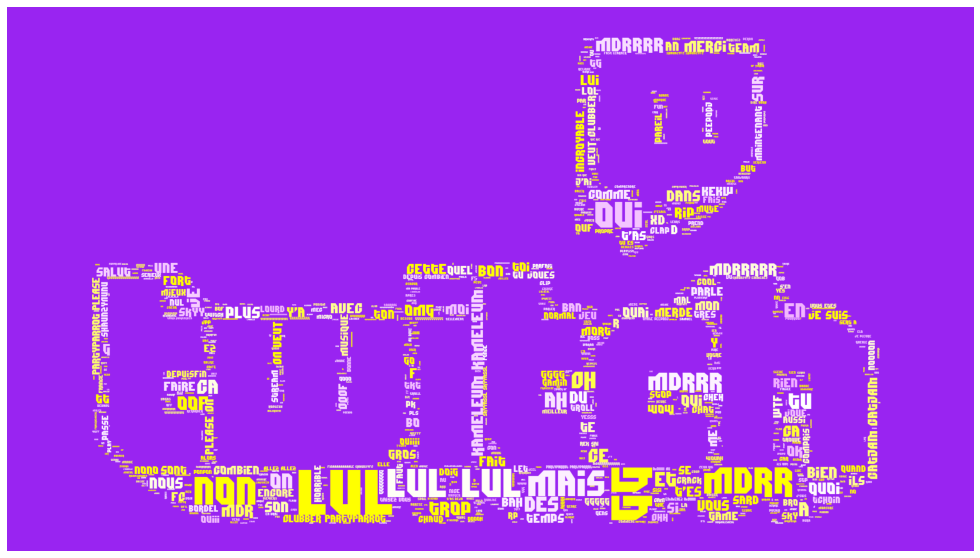

In [31]:
wordcloud = WordCloud(background_color = '#9924f1',font_path="polic.ttf",color_func=random_color_func, max_words = len(chats),width=1600,mask = mask, height=800,stopwords = ['de','la','c est','il','est','que','va','pour','a',"c'est",'pas','c','le','les','un']).generate(text)
plt.figure( figsize=(20,10))
plt.tight_layout(pad=0)
plt.axis("off")
plt.imshow(wordcloud)
plt.show();

## Create a pie chart

In [39]:
follow = follow[follow["event_type"] == "follow"]
follow

,event_type,day,device_id,player,login,channel,context
0,follow,2016-12-05 13:41:34,b0b58dc9e6ad4cd9b74597548dd92252,android,karrris,siraza,NaN
1,follow,2017-01-07 09:04:45,b0b58dc9e6ad4cd9b74597548dd92252,android,karrris,asusrog,NaN
2,follow,2017-02-01 13:14:34,b0b58dc9e6ad4cd9b74597548dd92252,android,karrris,skyyart,NaN
3,follow,2017-02-06 08:42:26,b0b58dc9e6ad4cd9b74597548dd92252,android,karrris,faker,NaN
4,follow,2017-02-07 10:08:40,b0b58dc9e6ad4cd9b74597548dd92252,android,karrris,quinnmastermind,NaN
...,...,...,...,...,...,...,...
106,follow,2021-05-13 03:41:30,2da5e60a236b3893,web,kohrfuz,xurei,source=channel
107,follow,2021-05-17 23:01:34,2da5e60a236b3893,web,kohrfuz,mizu,source=channel
108,follow,2021-06-17 23:54:35,8cb6db5fa09341549a2f5fcc53b2709f,android,kohrfuz,hittheroadlive,NaN
109,follow,2021-09-04 04:39:46,YxPBNWdDA1P2gLZsQZIDJdyvw2tWRXDN,web,furraly,linca,source=channel


In [89]:
follow["day"] = pd.to_datetime(follow["day"])
follow["day"] = follow["day"].map(get_year)

In [100]:
x = follow.groupby("day").size()
x

day
2016     1
2017    11
2018     4
2019     4
2020    40
2021    35
dtype: int64

In [74]:
fig7 = go.Figure(data=[go.Pie(labels=["2016","2017","2018","2019","2020","2021"], values=x, hole=0.5, pull=[0.1, 0.1, 0.1, 0.1,0.03,0])])
fig7.update_traces(marker=dict(colors=['#03071e','#9d0208','#6a040f','#370617','#ffba08','#d00000']))
fig7.update_layout(title_text="Nombre de chaînes suivies par années",annotations=[dict(text='Total : 98', x=0.5, y=0.5, font_size=20, showarrow=False)])
fig7.update_traces(textinfo='value')

fig7.show()

## Create a sunburst

In [12]:
follow = follow[follow["event_type"] == "follow"]
follow = follow.drop_duplicates() #ISSUE
follow["day"] = pd.to_datetime(follow["day"])
follow["day"] = follow["day"].map(get_year)

NameError: name 'get_year' is not defined

In [6]:
fig10 = px.sunburst(follow, path=['day','channel'])
fig10.show()

______

## Fidelisation by channel

In [3]:
test = ads.groupby(["channel","event_type"]).agg('count')
test = test.reset_index()

In [4]:
response = test[((test["event_type"] == "video_ad_request_declined") & (test["day"] > 40)) | ((test["event_type"] == "video_ad_request_response") & (test["day"] > 170)) ]

In [5]:
index_names = response[response['channel'] == "solaryfortnite"].index
index_names2 = response[response['channel'] == "alexclick"  ].index              
index_names3 = response[response['channel'] == "rasmelthor" ].index                      
index_names4 = response[response['channel'] == "alderiate"  ].index                   
index_names5 = response[response['channel'] == "rocketbaguette"].index
index_names6 = response[response['channel'] == "lestream"   ].index                   
index_names7 = response[response['channel'] == "scream"     ].index              
index_names8 = response[response['channel'] == "squeezie"   ].index                         
                      
response.drop(index_names, inplace = True)
response.drop(index_names2, inplace = True)
response.drop(index_names3, inplace = True)
response.drop(index_names4, inplace = True)
response.drop(index_names5, inplace = True)
response.drop(index_names6, inplace = True)
response.drop(index_names7, inplace = True)
response.drop(index_names8, inplace = True)

/Users/benoit/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [6]:
for i in range (0,len(response) - 1):
    if i % 2 == 0:
        numb = response.iloc[i]["day"] + response.iloc[i+1]["day"]
        response.at[response.index[i], "day"] = (response.iloc[i]["day"] * 100) / numb
        if (((response.iloc[i+1]["day"] * 100) / numb) + response.iloc[i]["day"]) < 100:
            response.at[response.index[i+1], "day"] = ((response.iloc[i+1]["day"] * 100) / numb) + 1
        else:
            response.at[response.index[i+1], "day"] = (response.iloc[i+1]["day"] * 100) / numb

In [7]:
response = response.sort_values(by=["day"])

In [9]:
response

,channel,event_type,day,device_id,player,user_login,context
1315,sardoche,video_ad_request_declined,9,59,54,9,6
389,eclypsiatvlol,video_ad_request_declined,10,54,40,54,8
1694,zerator,video_ad_request_declined,11,82,75,38,27
437,etoiles,video_ad_request_declined,12,48,46,9,8
1263,rivenzi,video_ad_request_declined,12,59,59,5,11
1401,solary,video_ad_request_declined,13,125,86,34,34
92,antoinedaniellive,video_ad_request_declined,14,49,49,19,5
911,lutti,video_ad_request_declined,14,47,46,3,8
748,kennystream,video_ad_request_declined,14,45,43,15,13
1061,moman,video_ad_request_declined,15,44,43,8,4


In [8]:
fig = px.bar(response, x="day", y="channel",text='day', color="event_type",orientation='h', color_discrete_map={'video_ad_request_response': 'rgba(8,230,48,0.53)','video_ad_request_declined': 'rgba(230,18,27,0.95)'})
fig.update_layout(barmode='stack') 
fig.show()

## Time spend on preroll live ads 

In [13]:
ads = ads[(ads["event_type"] == "video_ad_impression") | (ads["event_type"] == "video_ad_impression_complete")]

In [18]:
ads = ads.sort_values(by=['channel',"day"])
ads["day"] = pd.to_datetime(ads["day"])

In [19]:
for i in range (0,len(ads)-1):
    if (ads.iloc[i]["event_type"] == "video_ad_impression") & (ads.iloc[i+1]["event_type"] == "video_ad_impression_complete"):
        ads.at[ads.index[i], "somme"] = pd.Timedelta(ads.iloc[i+1]["day"] - ads.iloc[i]["day"]).seconds

In [24]:
ads.dropna(subset = ["somme"], inplace=True)
ads = ads.groupby("channel").agg("sum")
ads = ads.reset_index()

In [25]:
ads["somme"] = ads["somme"] / 3600
ads = ads.sort_values(by=["somme"])

In [170]:
test = ads["somme"].sum()
test = test / len(ads)

In [169]:
fig = px.bar(ads[130:], x="channel", y="somme")
fig.update_layout(barmode='stack')
color = ['rgb(158,202,225)']*100
color[37] = "red"
color[36] = "red"
fig.update_traces(marker_color=color, marker_line_color='rgb(8,48,107)', opacity=0.8)
fig.add_shape(type="line",xref="paper",x0=0, y0=test,x1=1, y1=test,line=dict(color="#0A07EB",width=2,dash="dash"))
text=" - - moyenne d'heures passées par chaîne (8h) "
fig.add_annotation(x=0,y=200,text=text,xref="paper",font=dict(color="#0A08B0"),showarrow=False,font_size=10)
fig.show()

## On which device do I watch Twitch ? 

In [263]:
watched = watched[(watched["player"] == "site") | (watched["player"] == "mobile_player")]

In [264]:
test2 = watched.groupby(["channel_name","player"],as_index=False).agg("count")

In [299]:
le = preprocessing.LabelEncoder()
le.fit(test2["channel_name"])
trans = le.transform(test2["channel_name"])
test2["index"] = trans
test2 = test2[test2["event_type"] > 10]             

In [298]:

fig = px.scatter(test2, x="index", y="channel_name",size="event_type",color="player", symbol="player",color_discrete_map={'site': 'rgba(8,230,48,0.42)'})
fig.update_layout(yaxis={'categoryorder':'category descending'})
fig.show()

## Create an heatmap for hours

In [227]:
ads["day"] = pd.to_datetime(ads["day"])
ads = ads.set_index(["day"])

In [228]:
ads = ads.tz_localize('America/Los_Angeles').tz_convert('Europe/Paris')

In [229]:
ads = ads[(ads["event_type"] == "video_ad_impression") | (ads["event_type"] == "video_ad_request")]

In [230]:
ads = ads.reset_index()

In [233]:
ads["hours"] = ads["day"].map(get_hour) 

In [234]:
ads["week"] = ads["day"].map(get_weekday)

In [235]:
df = ads.groupby(['hours', 'week']).apply(count_rows2).unstack() #unstack command will change the Hours column to be above and horizontal

In [236]:
df = df.sort_index()
df = df.fillna(0)

In [239]:
print(df.index)

Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23],
           dtype='int64', name='hours')


In [237]:
fig3 = go.Figure(data=go.Heatmap(
                    z=df,
                    y=['0','1', '2', '3', '4','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23'],
                   x=['Lundi', 'Mardi','Mercredi','Jeudi','Vendredi','Samedi','Dimanche'],
                   hoverongaps = False, 
                    xgap=1,
                    ygap=1,
                    ))
fig3.update_layout(title='Heatmap représentant le nombre d"heures passées sur Twitch dans la semaine')
fig3.show()